$$
\newcommand{\mat}[1]{\boldsymbol {#1}}
\newcommand{\mattr}[1]{\boldsymbol {#1}^\top}
\newcommand{\matinv}[1]{\boldsymbol {#1}^{-1}}
\newcommand{\vec}[1]{\boldsymbol {#1}}
\newcommand{\vectr}[1]{\boldsymbol {#1}^\top}
\newcommand{\rvar}[1]{\mathrm {#1}}
\newcommand{\rvec}[1]{\boldsymbol{\mathrm{#1}}}
\newcommand{\diag}{\mathop{\mathrm {diag}}}
\newcommand{\set}[1]{\mathbb {#1}}
\newcommand{\norm}[1]{\left\lVert#1\right\rVert}
\newcommand{\pderiv}[2]{\frac{\partial #1}{\partial #2}}
\newcommand{\bb}[1]{\boldsymbol{#1}}
$$
# Part 6: YOLO - Objects Detection
<a id=part6></a>

In this part we will use an object detection architecture called YOLO (You only look once) to detect objects in images. We'll use an already trained model weights (v5) found here: https://github.com/ultralytics/yolov5

In [1]:
import torch

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)

# Load the YOLO model
model = torch.hub.load("ultralytics/yolov5", "yolov5s")
model.to(device)
# Images
img1 = 'imgs/DolphinsInTheSky.jpg'  
img2 = 'imgs/cat-shiba-inu-2.jpg' 

cpu


Using cache found in /Users/shakedgoldshtein/.cache/torch/hub/ultralytics_yolov5_master


requirements: Ultralytics requirements ['gitpython>=3.1.30', 'pillow>=10.3.0', 'urllib3>=2.5.0 ; python_version > "3.8"'] not found, attempting AutoUpdate...
WARNING ⚠️ Retry 1/2 failed: Command 'pip install --no-cache-dir "gitpython>=3.1.30" "pillow>=10.3.0" "urllib3>=2.5.0 ; python_version > "3.8"" ' returned non-zero exit status 2.
WARNING ⚠️ Retry 2/2 failed: Command 'pip install --no-cache-dir "gitpython>=3.1.30" "pillow>=10.3.0" "urllib3>=2.5.0 ; python_version > "3.8"" ' returned non-zero exit status 2.
WARNING ⚠️ requirements: ❌ Command 'pip install --no-cache-dir "gitpython>=3.1.30" "pillow>=10.3.0" "urllib3>=2.5.0 ; python_version > "3.8"" ' returned non-zero exit status 2.


YOLOv5 🚀 2025-12-24 Python-3.8.12 torch-1.10.1 CPU

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
Adding AutoShape... 


Adding AutoShape... 


## Inference with YOLO
<a id=part6_1></a>

You are provided with 2 images (img1 and img2).
**TODO**:
1. Detect objects using the YOLOv5 model for these 2 images.
2. Print the inference output with bounding boxes.
3. Look at the inference results and answer the question below.


inference output img 1:
image 1/1: 183x275 2 persons, 1 surfboard
Speed: 4.5ms pre-process, 94.6ms inference, 0.8ms NMS per image at shape (1, 3, 448, 640)
         xmin       ymin        xmax        ymax  confidence  class       name
0  100.278389  47.370995  187.863510  118.462646    0.903491      0     person
1   22.531372  20.887974  128.905212   92.257057    0.500975      0     person
2   85.618027  98.014679  139.018341  124.627907    0.367017     37  surfboard


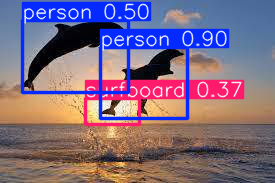

inference output img 2:
image 1/1: 750x750 2 cats, 1 dog
Speed: 7.0ms pre-process, 113.5ms inference, 0.5ms NMS per image at shape (1, 3, 640, 640)
         xmin        ymin        xmax        ymax  confidence  class name
0   11.568475  115.775024  312.757019  667.323669    0.655977     15  cat
1  363.715546  290.178589  750.000000  721.983704    0.509417     16  dog
2  311.190704  102.437454  595.031738  687.870605    0.391701     15  cat


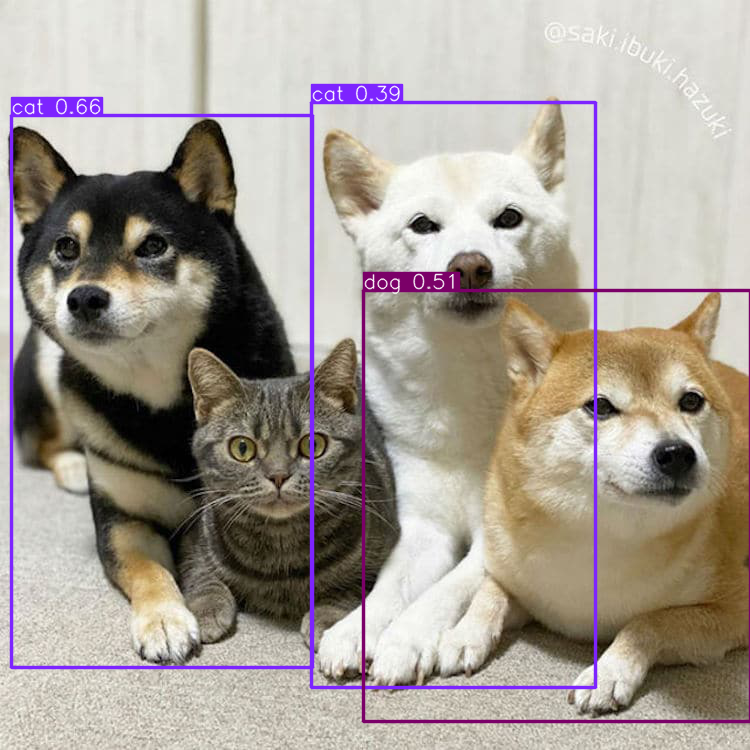

In [2]:
with torch.no_grad():
    #Detecting objects using YOLOv5
    objs_img1 = model(img1)
    objs_img2 = model(img2)

    #Printing inference output1 with bounding boxes
    print('inference output img 1:')
    print(objs_img1)
    print(objs_img1.pandas().xyxy[0])
    objs_img1.show()

    #Printing inference output2 with bounding boxes
    print('inference output img 2:')
    print(objs_img2)
    print(objs_img2.pandas().xyxy[0])
    objs_img2.show()

### Question 1

Analyze the inference results of the 2 images. 
1. How well did the model detect the objects in the pictures? with what confidance?
2. What can possibly be the reason for the model failures? suggest methods to resolve that issue.
3. recall that we learned how to fool a model by adverserial attack (PGD), describe how you would attack an Object Detection model (such as YOLO).

In [3]:
#====
from cs236781.answers import display_answer
import hw2.answers
#====

display_answer(hw2.answers.part6_q1)


**Your answer:**


Write your answer using **markdown** and $\LaTeX$:
```python
# A code block
a = 2
```
An equation: $e^{i\pi} -1 = 0$



## Creative Detection Failures

<a id=part6_2></a>

Object detection pitfalls could be, for example: **occlusion** - when the objects are partially occlude, and thus missing important features, **model bias** - when a model learn some bias about an object, it could recognize it as something else in a different setup, and many others like **Deformation**, **Illumination conditions**, **Cluttered** or **textured background and blurring** due to moving objects.

**TODO**: Take pictures and that demonstrates 3 of the above object detection pitfalls, run inference and analyze the results.

image 1/1: 4000x6000 1 person, 1 sports ball, 1 surfboard
Speed: 187.5ms pre-process, 81.4ms inference, 0.7ms NMS per image at shape (1, 3, 448, 640)
          xmin         ymin         xmax         ymax  confidence  class  \
0  2678.350098  1448.127075  3304.865479  2585.322998    0.888682      0   
1  1930.916626  2594.071045  3056.281006  2781.973877    0.455248     37   
2  2112.021729   962.567749  2249.055420  1083.203613    0.375569     32   

          name  
0       person  
1    surfboard  
2  sports ball  


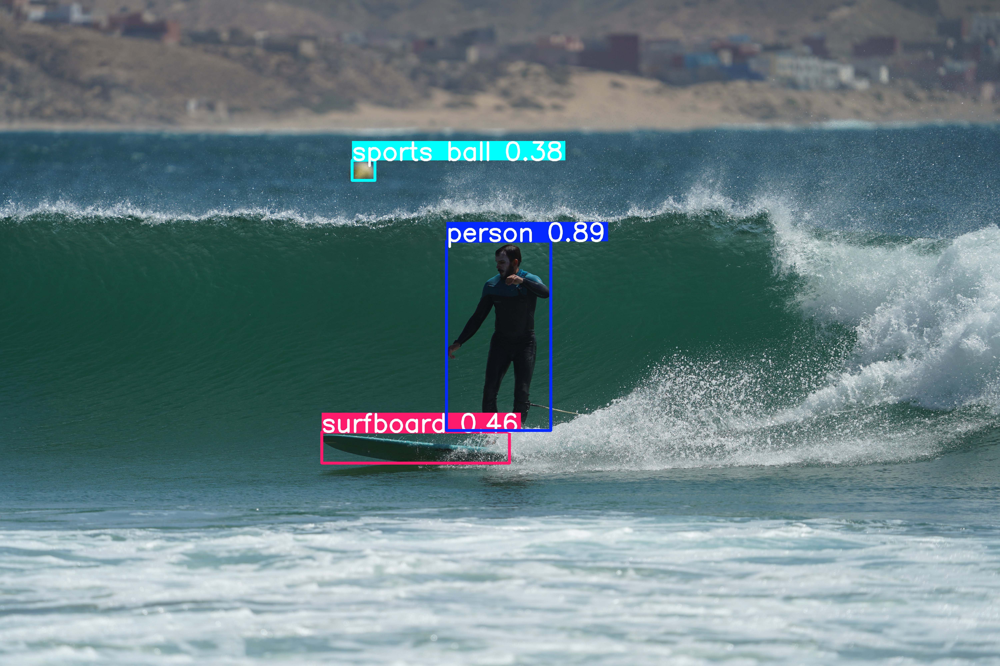

image 1/1: 1536x2048 1 person, 1 dog, 1 bottle, 1 chair, 1 potted plant, 1 bed
Speed: 27.1ms pre-process, 575.4ms inference, 0.7ms NMS per image at shape (1, 3, 480, 640)
         xmin        ymin         xmax         ymax  confidence  class  \
0  304.312897  323.490112  1492.233154  1042.287964    0.676184     16   
1  333.377716   94.158035   412.441711   242.091797    0.516974     39   
2  170.952087    1.698322   409.410583   183.126877    0.442513     58   
3   90.417282  875.406128  2019.814453  1522.978027    0.308031     59   
4    1.284058   10.038843   218.413132   764.381165    0.296443      0   
5    1.262293  113.296776   341.493408  1018.825867    0.271760     56   

           name  
0           dog  
1        bottle  
2  potted plant  
3           bed  
4        person  
5         chair  


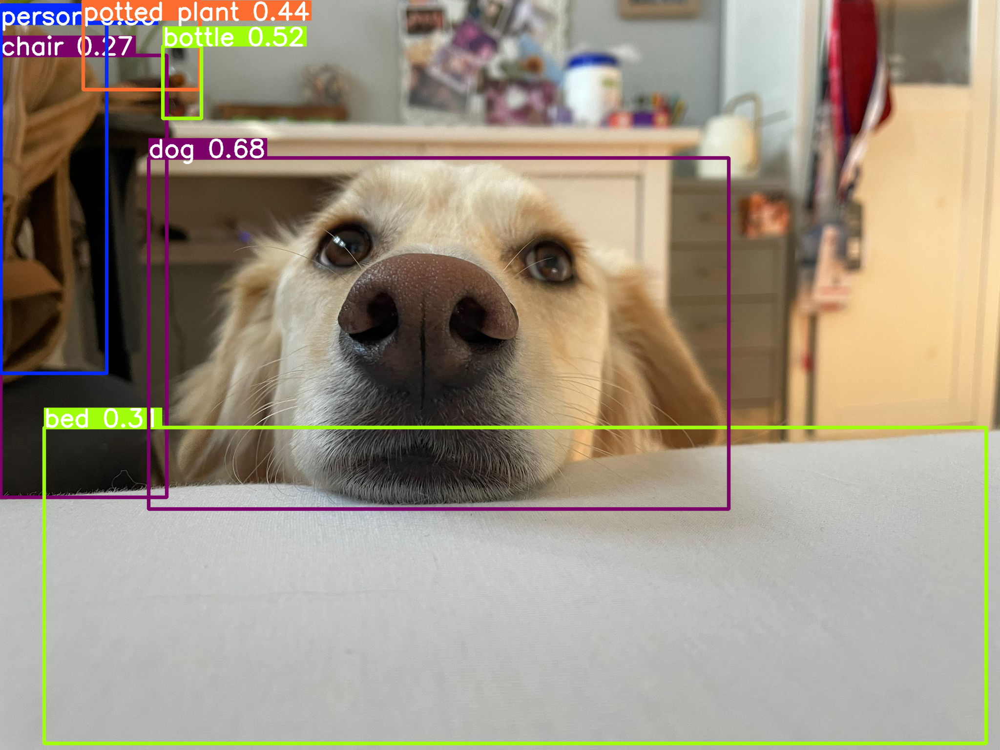

image 1/1: 349x244 1 person, 1 car
Speed: 4.4ms pre-process, 105.7ms inference, 0.4ms NMS per image at shape (1, 3, 640, 448)
        xmin       ymin        xmax        ymax  confidence  class    name
0  12.875851  23.452765  221.901917  346.528839    0.857520      0  person
1  19.491468  53.703037   95.812828  106.247246    0.797599      2     car


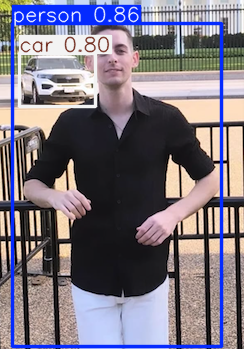

In [5]:
# You can change the images names in the code below, and add new ones

images = [
    "imgs/1.JPG",
    "imgs/2.jpg",
    "imgs/3.png"
]

with torch.no_grad():
    for img in images:
        objs_img = model(img)
        print(objs_img)
        print(objs_img.pandas().xyxy[0])
        objs_img.show()

### Question 3

Analyize the results of the inference. 
1. How well did the model detect the objects in the pictures? explain.


In [ ]:
display_answer(hw2.answers.part6_q3)


## Bonus 
<a id=part6_3></a>

Try improving the model performance over poorly recognized images by changing them. 
Describe the manipulations you did to the pictures.

In [6]:
import cv2

#insert bonus code here



requirements: Ultralytics requirements ['gitpython>=3.1.30', 'pillow>=10.3.0', 'urllib3>=2.5.0 ; python_version > "3.8"'] not found, attempting AutoUpdate...


Using cache found in /Users/shakedgoldshtein/.cache/torch/hub/ultralytics_yolov5_master


WARNING ⚠️ Retry 1/2 failed: Command 'pip install --no-cache-dir "gitpython>=3.1.30" "pillow>=10.3.0" "urllib3>=2.5.0 ; python_version > "3.8"" ' returned non-zero exit status 2.
WARNING ⚠️ Retry 2/2 failed: Command 'pip install --no-cache-dir "gitpython>=3.1.30" "pillow>=10.3.0" "urllib3>=2.5.0 ; python_version > "3.8"" ' returned non-zero exit status 2.
WARNING ⚠️ requirements: ❌ Command 'pip install --no-cache-dir "gitpython>=3.1.30" "pillow>=10.3.0" "urllib3>=2.5.0 ; python_version > "3.8"" ' returned non-zero exit status 2.


YOLOv5 🚀 2025-12-24 Python-3.8.12 torch-1.10.1 CPU

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
Adding AutoShape... 



===== DOLPHINS IMAGE =====
=== INITIAL DETECTION ===


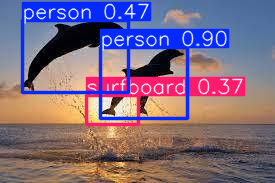


Refining object 0 (person)

Refining object 1 (person)

Refining object 2 (surfboard)

No refined detections.

===== CATS / DOGS IMAGE =====
=== INITIAL DETECTION ===


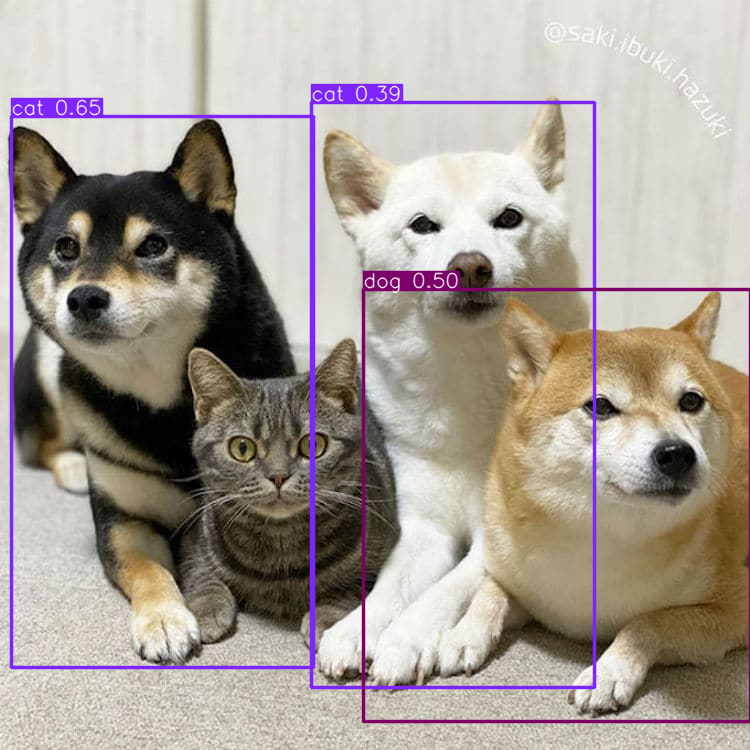


Refining object 0 (cat)

Refining object 1 (dog)

Refining object 2 (cat)

=== REFINED RESULTS ===
[xmin           11.445313
ymin           17.783251
xmax           302.32666
ymax          553.977905
confidence       0.59888
class                 15
name                 cat
Name: 0, dtype: object, xmin           10.633315
ymin           210.69281
xmax          291.879028
ymax          588.836731
confidence      0.505908
class                 15
name                 cat
Name: 0, dtype: object]


In [ ]:
import torch
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle

# -----------------------------
# Load YOLOv5
# -----------------------------
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = torch.hub.load("ultralytics/yolov5", "yolov5s")
model.to(device)

# Restrict to relevant classes (person, cat, dog, surfboard, boat)
model.classes = [0, 15, 16, 37, 8]
model.conf = 0.25

# Create a refined model with higher confidence for refinement step
refined_model = torch.hub.load("ultralytics/yolov5", "yolov5s")
refined_model.to(device)
refined_model.classes = [0, 15, 16, 37, 8]
refined_model.conf = 0.4  # Higher confidence for refinement

# -----------------------------
# Utility functions
# -----------------------------
def load_rgb(path):
    img = cv2.imread(path)
    if img is None:
        raise ValueError(f"Could not load image from {path}")
    return cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

def crop(img, box, pad=15):
    h, w, _ = img.shape
    x1, y1, x2, y2 = map(int, box)
    x1, y1 = max(0, x1-pad), max(0, y1-pad)
    x2, y2 = min(w, x2+pad), min(h, y2+pad)
    cropped = img[y1:y2, x1:x2]
    # Ensure minimum size for detection
    if cropped.shape[0] < 32 or cropped.shape[1] < 32:
        return None
    return cropped

def draw_boxes(img, detections, color='red', linewidth=2):
    """Draw bounding boxes on image"""
    img_copy = img.copy()
    for _, det in detections.iterrows():
        x1, y1, x2, y2 = int(det.xmin), int(det.ymin), int(det.xmax), int(det.ymax)
        label = f"{det['name']} {det.confidence:.2f}"
        cv2.rectangle(img_copy, (x1, y1), (x2, y2), color, linewidth)
        cv2.putText(img_copy, label, (x1, y1-10), 
                   cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)
    return img_copy

def show(img, title, figsize=(6, 6)):
    plt.figure(figsize=figsize)
    plt.imshow(img)
    plt.axis("off")
    plt.title(title, fontsize=12)
    plt.tight_layout()
    plt.show()

# -----------------------------
# Core refinement pipeline
# -----------------------------
def refined_detection(image_path):
    img = load_rgb(image_path)
    h, w = img.shape[:2]

    print("=== INITIAL DETECTION ===")
    results = model(img)
    results.show()
    df = results.pandas().xyxy[0]
    
    if len(df) == 0:
        print("No initial detections found.")
        return

    print(f"Found {len(df)} initial detections")
    refined_detections = []

    for i, row in df.iterrows():
        original_box = [row.xmin, row.ymin, row.xmax, row.ymax]
        obj_crop = crop(img, original_box)

        if obj_crop is None or obj_crop.size == 0:
            print(f"\nSkipping object {i} ({row['name']}): crop too small")
            continue

        print(f"\nRefining object {i}: {row['name']} (conf: {row.confidence:.2f})")
        print(f"  Original box: [{original_box[0]:.1f}, {original_box[1]:.1f}, {original_box[2]:.1f}, {original_box[3]:.1f}]")
        
        # Run detection on cropped region with higher confidence
        crop_results = refined_model(obj_crop)
        crop_df = crop_results.pandas().xyxy[0]

        if len(crop_df) == 0:
            print(f"  No refined detection found (confidence too low)")
            # Keep original if refinement found nothing
            refined_detections.append(row)
            continue

        # Select best detection (highest confidence)
        best_det = crop_df.loc[crop_df['confidence'].idxmax()]
        print(f"  Refined: {best_det['name']} (conf: {best_det.confidence:.2f})")

        # Transform coordinates back to original image
        crop_x1, crop_y1 = int(original_box[0]), int(original_box[1])
        refined_box = {
            'xmin': crop_x1 + best_det.xmin,
            'ymin': crop_y1 + best_det.ymin,
            'xmax': crop_x1 + best_det.xmax,
            'ymax': crop_y1 + best_det.ymax,
            'name': best_det['name'],
            'confidence': best_det.confidence,
            'class': best_det['class']
        }
        
        # Update row with refined values
        refined_row = row.copy()
        refined_row['xmin'] = refined_box['xmin']
        refined_row['ymin'] = refined_box['ymin']
        refined_row['xmax'] = refined_box['xmax']
        refined_row['ymax'] = refined_box['ymax']
        refined_row['name'] = refined_box['name']
        refined_row['confidence'] = refined_box['confidence']
        refined_row['class'] = refined_box['class']
        
        refined_detections.append(refined_row)

    if len(refined_detections) > 0:
        print("\n=== REFINED RESULTS SUMMARY ===")
        refined_df = pd.DataFrame(refined_detections)
        for idx, det in refined_df.iterrows():
            print(f"  {det['name']}: confidence={det.confidence:.3f}, "
                  f"box=[{det.xmin:.1f}, {det.ymin:.1f}, {det.xmax:.1f}, {det.ymax:.1f}]")
        
        # Visualize refined results on original image
        print("\n=== VISUALIZATION: REFINED DETECTIONS ===")
        refined_img = draw_boxes(img, refined_df, color='green', linewidth=2)
        show(refined_img, "Refined Detections", figsize=(10, 10))
        
        # Compare with original
        print("\n=== COMPARISON: ORIGINAL vs REFINED ===")
        original_img = draw_boxes(img, df, color='red', linewidth=2)
        fig, axes = plt.subplots(1, 2, figsize=(16, 8))
        axes[0].imshow(original_img)
        axes[0].set_title("Original Detections", fontsize=14)
        axes[0].axis('off')
        axes[1].imshow(refined_img)
        axes[1].set_title("Refined Detections", fontsize=14)
        axes[1].axis('off')
        plt.tight_layout()
        plt.show()
    else:
        print("\nNo refined detections after processing.")

# -----------------------------
# Run on problematic images
# -----------------------------
print("\n===== DOLPHINS IMAGE =====")
refined_detection("imgs/DolphinsInTheSky.jpg")

print("\n===== CATS / DOGS IMAGE =====")
refined_detection("imgs/cat-shiba-inu-2.jpg")